In [184]:
import datashader as ds
import datashader.transfer_functions as tf
import datashader.glyphs
from datashader import reductions
from datashader.core import bypixel
from datashader.utils import lnglat_to_meters as webm, export_image
from datashader.colors import colormap_select, Greys9, viridis, inferno
import copy

# to show color_key
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from pyproj import Proj, transform
import numpy as np
import pandas as pd
import urllib
import json
import datetime
import colorlover as cl

import plotly.offline as py
import plotly.graph_objs as go
from plotly import tools

# filter out warnings
import warnings
warnings.filterwarnings('ignore')

from shapely.geometry import Point, Polygon, shape
# In order to get shapley, you'll need to run [pip install shapely.geometry] from your terminal

from functools import partial

from IPython.display import GeoJSON

py.init_notebook_mode()

For module 2 we'll be looking at techniques for dealing with big data. In particular binning strategies and the datashader library (which possibly proves we'll never need to bin large data for visualization ever again.)

To demonstrate these concepts we'll be looking at the PLUTO dataset put out by New York City's department of city planning. PLUTO contains data about every tax lot in New York City.

PLUTO data can be downloaded from [here](https://www1.nyc.gov/site/planning/data-maps/open-data/dwn-pluto-mappluto.page). Unzip them to the same directory as this notebook, and you should be able to read them in using this (or very similar) code. Also take note of the data dictionary, it'll come in handy for this assignment.

In [125]:
# Code to read in v17, column names have been updated (without upper case letters) for v18

# bk = pd.read_csv('PLUTO17v1.1/BK2017V11.csv')
# bx = pd.read_csv('PLUTO17v1.1/BX2017V11.csv')
# mn = pd.read_csv('PLUTO17v1.1/MN2017V11.csv')
# qn = pd.read_csv('PLUTO17v1.1/QN2017V11.csv')
# si = pd.read_csv('PLUTO17v1.1/SI2017V11.csv')

# ny = pd.concat([bk, bx, mn, qn, si], ignore_index=True)

ny = pd.read_csv('nyc_pluto_22v3_1_csv/pluto_22v3_1.csv')


# Getting rid of some outliers
ny = ny[(ny['yearbuilt'] > 1850) & (ny['yearbuilt'] < 2020) & (ny['numfloors'] != 0)]

I'll also do some prep for the geographic component of this data, which we'll be relying on for datashader.

You're not required to know how I'm retrieving the lattitude and longitude here, but for those interested: this dataset uses a flat x-y projection (assuming for a small enough area that the world is flat for easier calculations), and this needs to be projected back to traditional lattitude and longitude.

In [126]:


# wgs84 = Proj("+proj=longlat +ellps=GRS80 +datum=NAD83 +no_defs")
# nyli = Proj("+proj=lcc +lat_1=40.66666666666666 +lat_2=41.03333333333333 +lat_0=40.16666666666666 +lon_0=-74 +x_0=300000 +y_0=0 +ellps=GRS80 +datum=NAD83 +to_meter=0.3048006096012192 +no_defs")
# ny['xcoord'] = 0.3048*ny['xcoord']
# ny['ycoord'] = 0.3048*ny['ycoord']
# ny['lon'], ny['lat'] = transform(nyli, wgs84, ny['xcoord'].values, ny['ycoord'].values)



# ny = ny[(ny['lon'] < -60) & (ny['lon'] > -100) & (ny['lat'] < 60) & (ny['lat'] > 20)]

#Defining some helper functions for DataShader
background = "black"
export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

## Part 1: Binning and Aggregation

Binning is a common strategy for visualizing large datasets. Binning is inherent to a few types of visualizations, such as histograms and [2D histograms](https://plot.ly/python/2D-Histogram/) (also check out their close relatives: [2D density plots](https://plot.ly/python/2d-density-plots/) and the more general form: [heatmaps](https://plot.ly/python/heatmaps/).

While these visualization types explicitly include binning, any type of visualization used with aggregated data can be looked at in the same way. For example, lets say we wanted to look at building construction over time. This would be best viewed as a line graph, but we can still think of our results as being binned by year:

In [127]:
trace = go.Scatter(
    # I'm choosing BBL here because I know it's a unique key.
    x = ny.groupby('yearbuilt').count()['bbl'].index,
    y = ny.groupby('yearbuilt').count()['bbl']
)

layout = go.Layout(
    xaxis = dict(title = 'Year Built'),
    yaxis = dict(title = 'Number of Lots Built')
)

fig = go.FigureWidget(data = [trace], layout = layout)

fig

FigureWidget({
    'data': [{'type': 'scatter',
              'uid': '022bd98e-455d-4719-a4a8-117df35c63b6',
 …

Something looks off... You're going to have to deal with this imperfect data to answer this first question. 

But first: some notes on pandas. Pandas dataframes are a different beast than R dataframes, here are some tips to help you get up to speed:

---

Hello all, here are some pandas tips to help you guys through this homework:

[Indexing and Selecting](https://pandas.pydata.org/pandas-docs/stable/indexing.html): .loc and .iloc are the analogs for base R subsetting, or filter() in dplyr

[Group By](https://pandas.pydata.org/pandas-docs/stable/groupby.html):  This is the pandas analog to group_by() and the appended function the analog to summarize(). Try out a few examples of this, and display the results in Jupyter. Take note of what's happening to the indexes, you'll notice that they'll become hierarchical. I personally find this more of a burden than a help, and this sort of hierarchical indexing leads to a fundamentally different experience compared to R dataframes. Once you perform an aggregation, try running the resulting hierarchical datafrome through a [reset_index()](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.reset_index.html).

[Reset_index](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.reset_index.html): I personally find the hierarchical indexes more of a burden than a help, and this sort of hierarchical indexing leads to a fundamentally different experience compared to R dataframes. reset_index() is a way of restoring a dataframe to a flatter index style. Grouping is where you'll notice it the most, but it's also useful when you filter data, and in a few other split-apply-combine workflows. With pandas indexes are more meaningful, so use this if you start getting unexpected results.

Indexes are more important in Pandas than in R. If you delve deeper into the using python for data science, you'll begin to see the benefits in many places (despite the personal gripes I highlighted above.) One place these indexes come in handy is with time series data. The pandas docs have a [huge section](http://pandas.pydata.org/pandas-docs/stable/timeseries.html) on datetime indexing. In particular, check out [resample](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.resample.html), which provides time series specific aggregation.

[Merging, joining, and concatenation](https://pandas.pydata.org/pandas-docs/stable/merging.html): There's some overlap between these different types of merges, so use this as your guide. Concat is a single function that replaces cbind and rbind in R, and the results are driven by the indexes. Read through these examples to get a feel on how these are performed, but you will have to manage your indexes when you're using these functions. Merges are fairly similar to merges in R, similarly mapping to SQL joins.

Apply: This is explained in the "group by" section linked above. These are your analogs to the plyr library in R. Take note of the lambda syntax used here, these are anonymous functions in python. Rather than predefining a custom function, you can just define it inline using lambda.

Browse through the other sections for some other specifics, in particular reshaping and categorical data (pandas' answer to factors.) Pandas can take a while to get used to, but it is a pretty strong framework that makes more advanced functions easier once you get used to it. Rolling functions for example follow logically from the apply workflow (and led to the best google results ever when I first tried to find this out and googled "pandas rolling")

Google Wes Mckinney's book "Python for Data Analysis," which is a cookbook style intro to pandas. It's an O'Reilly book that should be pretty available out there.

---

### Question 1

<b>After a few building collapses, the City of New York is going to begin investigating older buildings for safety. The city is particularly worried about buildings that were unusually tall when they were built, since best-practices for safety hadn’t yet been determined. Create a graph that shows how many buildings of a certain number of floors were built in each year (note: you may want to use a log scale for the number of buildings). Find a strategy to bin buildings (It should be clear 20-29-story buildings, 30-39-story buildings, and 40-49-story buildings were first built in large numbers, but does it make sense to continue in this way as you get taller?)</b>

In [128]:
# Start your answer here, inserting more cells as you go along
# view all cols
pd.set_option("display.max_columns", None)

# preview data
ny.head()

,borough,block,lot,cd,bct2020,bctcb2020,ct2010,cb2010,schooldist,council,zipcode,firecomp,policeprct,healthcenterdistrict,healtharea,sanitboro,sanitdistrict,sanitsub,address,zonedist1,zonedist2,zonedist3,zonedist4,overlay1,overlay2,spdist1,spdist2,spdist3,ltdheight,splitzone,bldgclass,landuse,easements,ownertype,ownername,lotarea,bldgarea,comarea,resarea,officearea,retailarea,garagearea,strgearea,factryarea,otherarea,areasource,numbldgs,numfloors,unitsres,unitstotal,lotfront,lotdepth,bldgfront,bldgdepth,ext,proxcode,irrlotcode,lottype,bsmtcode,assessland,assesstot,exempttot,yearbuilt,yearalter1,yearalter2,histdist,landmark,builtfar,residfar,commfar,facilfar,borocode,bbl,condono,tract2010,xcoord,ycoord,zonemap,zmcode,sanborn,taxmap,edesignum,appbbl,appdate,plutomapid,firm07_flag,pfirm15_flag,version,dcpedited,latitude,longitude,notes
0,BK,1809,16,303.0,3026500.0,3.026500e+10,265.0,2001.0,13.0,36.0,11216.0,E235,79.0,32.0,2000.0,3.0,3.0,3B,358 QUINCY STREET,R6B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,A4,1.0,0.0,NaN,"SIMPSON, EVON",2017.0,1210.0,0.0,1210.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,2.0,1.0,1.0,20.17,100.00,20.17,30.0,N,2.0,N,5.0,2.0,14700.0,58800.0,0.0,1899.0,0.0,0.0,NaN,NaN,0.60,2.00,0.0,2.0,3,3.018090e+09,NaN,265.0,999060.0,189645.0,17a,NaN,305 017,30610.0,NaN,NaN,NaN,1,NaN,NaN,22v3.1,NaN,40.687196,-73.946599,NaN
1,BK,6183,33,311.0,3026600.0,3.026600e+10,266.0,3000.0,20.0,47.0,11204.0,L168,62.0,31.0,8300.0,3.0,11.0,2D,1862 71 STREET,R5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,B1,1.0,0.0,NaN,"QIAN, JIA LIN",1833.0,1551.0,0.0,1551.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,2.0,2.0,2.0,18.33,100.00,18.33,42.5,N,2.0,N,5.0,1.0,15960.0,58740.0,0.0,1930.0,0.0,0.0,NaN,NaN,0.85,1.25,0.0,2.0,3,3.061830e+09,NaN,266.0,986388.0,163190.0,22d,NaN,312 061,31901.0,NaN,NaN,NaN,1,NaN,NaN,22v3.1,NaN,40.614595,-73.992299,NaN
2,BK,6206,22,311.0,3026800.0,3.026800e+10,268.0,3000.0,20.0,47.0,11204.0,L168,62.0,31.0,8300.0,3.0,11.0,2D,1942 73 STREET,R5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,B1,1.0,0.0,NaN,"WU, CHAO BEN",2424.0,2352.0,0.0,2352.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,2.0,2.0,24.25,100.00,21.00,48.0,G,2.0,N,5.0,2.0,12720.0,87060.0,1460.0,1930.0,0.0,0.0,NaN,NaN,0.97,1.25,0.0,2.0,3,3.062060e+09,NaN,268.0,986515.0,162427.0,22d,NaN,312 070,31902.0,NaN,NaN,NaN,1,NaN,NaN,22v3.1,NaN,40.612501,-73.991842,NaN
3,BK,1852,37,303.0,3026900.0,3.026900e+10,269.0,1001.0,13.0,36.0,11216.0,E235,79.0,32.0,2800.0,3.0,3.0,3A,234A MACON STREET,R6B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,C0,2.0,0.0,NaN,"COX, PIERRE OLIVER",1400.0,2124.0,0.0,1411.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,3.0,3.0,3.0,17.50,80.00,17.50,40.0,N,3.0,N,5.0,1.0,11220.0,83400.0,0.0,1899.0,0.0,0.0,NaN,NaN,1.52,2.00,0.0,2.0,3,3.018520e+09,NaN,269.0,1000530.0,187690.0,17a,NaN,305 032,30612.0,NaN,NaN,NaN,1,NaN,NaN,22v3.1,NaN,40.681827,-73.941303,NaN
4,BK,5893,8,310.0,3013000.0,3.013000e+10,130.0,2001.0,20.0,43.0,11209.0,L109,68.0,31.0,7700.0,3.0,10.0,1C,7115 5 AVENUE,R6B,NaN,NaN,NaN,C1-3,NaN,BR,NaN,NaN,NaN,N,S2,4.0,0.0,NaN,"KOURLAS, DINA",1779.0,3132.0,1034.0,2098.0,0.0,1034.0,0.0,0.0,0.0,0.0,2.0,1.0,3.0,2.0,3.0,19.08,93.25,19.17,54.0,N,0.0,N,5.0,2.0,20760.0,78540.0,0.0,1907.0,0.0,0.0,NaN,NaN,1.76,2.00,0.0,2.0,3,3.058930e+09,NaN,130.0,978343.0,169549.0,22a,NaN,311 046,31803.0,NaN,NaN,NaN,1,NaN,NaN,22v3.1,NaN,40.632047,-74.021282,NaN


### Data explanation
Let's focus on the columns that I know will be important for this visualation:

- `borough` - borough of lot
- `zipcode` - zip code of lot
- `bldgclass` - building class
- `numbldgs` - amount of buildings on lot
- `numfloors` - number of floors not including basement or roof parking
- `yearbuilt` - year the building was built
- `bbl` - borough, block, tax and lot (unique for each record)
- `assessland` - assessed land value 
- `assesstot` - assessed lot value
- `xcoord`/`ycoord` - coordinates, could provide useful for geospatial visualation

Next up we need to get some summary statistics and dtype info about the <i>in focus</i> columns.

### Filter data

Let's filter dataframe to include only the aforementioned columns.


In [129]:
# select in focus columns
in_focus = ['borough','zipcode','bldgclass','numbldgs','numfloors','yearbuilt','bbl','assessland','assesstot','xcoord','ycoord']

# filter in focus
ny_filtered = ny[in_focus]

# get dataset dimensions
ny_filtered.shape

(811695, 11)

Ok, so now we have over 800,000 rows and 11 columns. Each record is a tax lot, however some have multiple buildings.
Now let's get some descriptive statistics.

### Summary Statistics

Let's get some summary stats on these filtered columns and go from there.

In [185]:
# view two numeric columns of interest
ny_filtered.describe()

,zipcode,numbldgs,numfloors,yearbuilt,bbl,assessland,assesstot,xcoord,ycoord,assessbldg
count,809160.000000,809160.000000,809160.000000,809160.000000,8.091600e+05,8.091600e+05,8.091600e+05,8.091600e+05,809160.000000,8.091600e+05
mean,11020.326618,1.319022,2.460269,1941.084559,3.523440e+09,1.111696e+05,5.230667e+05,1.006361e+06,191342.636716,4.118971e+05
std,466.781854,2.704107,1.944972,30.511581,1.017733e+09,4.170890e+06,1.126870e+07,3.255392e+04,30499.452076,7.550070e+06
min,10001.000000,0.000000,1.000000,1851.000000,1.000010e+09,0.000000e+00,0.000000e+00,9.131640e+05,120966.000000,0.000000e+00
25%,10466.000000,1.000000,2.000000,1920.000000,3.033660e+09,1.038000e+04,4.152000e+04,9.896710e+05,168052.000000,2.952000e+04
50%,11222.000000,1.000000,2.000000,1931.000000,4.009000e+09,1.416000e+04,5.682000e+04,1.009046e+06,189082.000000,4.224000e+04
75%,11370.000000,2.000000,2.750000,1960.000000,4.105393e+09,2.190000e+04,1.010400e+05,1.029558e+06,210815.000000,7.830000e+04
max,12345.000000,1854.000000,104.000000,2019.000000,5.080500e+09,3.205634e+09,7.548921e+09,1.067279e+06,272275.000000,4.343287e+09


So we can see that `numgldgs` varies drastically, and `yearbuilt` goes from 1851 - 2019.
`numfloors` has a min of 1, and maxes out at 104. However, most building are 1-3 stories.

Let's use info to inspect as well.

In [186]:
ny_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 809160 entries, 0 to 858617
Data columns (total 16 columns):
 #   Column         Non-Null Count   Dtype   
---  ------         --------------   -----   
 0   borough        809160 non-null  object  
 1   zipcode        809160 non-null  float64 
 2   bldgclass      809160 non-null  object  
 3   numbldgs       809160 non-null  float64 
 4   numfloors      809160 non-null  float64 
 5   yearbuilt      809160 non-null  float64 
 6   bbl            809160 non-null  float64 
 7   assessland     809160 non-null  float64 
 8   assesstot      809160 non-null  float64 
 9   xcoord         809160 non-null  float64 
 10  ycoord         809160 non-null  float64 
 11  numfloors_bin  809160 non-null  category
 12  assessbldg     809160 non-null  float64 
 13  land_bin       809160 non-null  category
 14  build_bin      809160 non-null  category
 15  color_key      809160 non-null  category
dtypes: category(4), float64(10), object(2)
memory usage: 115

We can see that `numfloors` is the only column with NA values, about ~2k. We will drop these rows for this analysis.

In [187]:
# drop na
ny_filtered = ny_filtered.dropna(how='any')

# view info again
ny_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 809160 entries, 0 to 858617
Data columns (total 16 columns):
 #   Column         Non-Null Count   Dtype   
---  ------         --------------   -----   
 0   borough        809160 non-null  object  
 1   zipcode        809160 non-null  float64 
 2   bldgclass      809160 non-null  object  
 3   numbldgs       809160 non-null  float64 
 4   numfloors      809160 non-null  float64 
 5   yearbuilt      809160 non-null  float64 
 6   bbl            809160 non-null  float64 
 7   assessland     809160 non-null  float64 
 8   assesstot      809160 non-null  float64 
 9   xcoord         809160 non-null  float64 
 10  ycoord         809160 non-null  float64 
 11  numfloors_bin  809160 non-null  category
 12  assessbldg     809160 non-null  float64 
 13  land_bin       809160 non-null  category
 14  build_bin      809160 non-null  category
 15  color_key      809160 non-null  category
dtypes: category(4), float64(10), object(2)
memory usage: 115


Let's use pandas `groupby()` function to view a few of the categorical variables

In [188]:
# groupby borough for count of records by borough
ny_filtered.groupby('borough').size()

borough
BK    263036
BX     82498
MN     38360
QN    310934
SI    114332
dtype: int64

Let's look at number of buildings per borough, because there can be multiple buildings per record or tax lot.

In [189]:
# groupby borough sum by number of buildings per borough
ny_filtered.groupby('borough')['numbldgs'].sum()

borough
BK    326657.0
BX    102843.0
MN     42939.0
QN    457388.0
SI    137473.0
Name: numbldgs, dtype: float64

This is a very differnt number then a pure count per borough. According to the data dictionary, `numbldgs` is the number of buildings on each tax lot. This could prove important when visualizing buildings built per year in NYC.

Let's view `numfloors` to get an idea of the distribution.

In [191]:
trace = go.Histogram(
    x = ny_filtered['numfloors'],
    nbinsx=200
)

layout = go.Layout(
    xaxis = dict(title = 'Number of floors'),
    yaxis = dict(title = 'Count')
)

fig = go.FigureWidget(data = [trace], layout = layout)

fig

FigureWidget({
    'data': [{'nbinsx': 200,
              'type': 'histogram',
              'uid': '414e472b-…

We can see the majority are between 0 - 4.99 and then it tapers off from there. Definetly right skewed.

Ok, so now we can group by year, then floor count and count up number of unique `bbl` per `yearbuilt` and `numfloors`.

In [137]:
# multi groupby number of floors and year
ny_filtered_grp_yr_flr = ny_filtered.groupby(['yearbuilt','numfloors']).agg({'bbl':'count'})\
    .reset_index().rename(columns={'bbl':'bbl_count'})

# preview
ny_filtered_grp_yr_flr.head(10)

,yearbuilt,numfloors,bbl_count
0,1851.0,2.0,5
1,1851.0,2.5,2
2,1851.0,3.0,43
3,1851.0,3.5,4
4,1851.0,4.0,22
5,1851.0,5.0,12
6,1851.0,6.0,2
7,1851.0,7.0,2
8,1852.0,1.0,1
9,1852.0,2.0,8


This gives us the `bbl` count per `yearbuilt` per `numfloors`, but doesn't give us `numbldgs`. Let's try and get `numbldgs` and then do the same groupby.

In [138]:
# sum up numbldgs per year, per numfloors
ny_filtered_grp_yr_flr_num = ny_filtered.groupby(['yearbuilt','numfloors']).agg({'bbl':'count','numbldgs':'sum'})\
.reset_index().rename(columns={'bbl':'bbl_count','numbldgs':'numbldgs_count'})

# preview
ny_filtered_grp_yr_flr_num.head()

,yearbuilt,numfloors,bbl_count,numbldgs_count
0,1851.0,2.0,5,5.0
1,1851.0,2.5,2,2.0
2,1851.0,3.0,43,43.0
3,1851.0,3.5,4,4.0
4,1851.0,4.0,22,24.0


In [139]:
# view rows of grouped
ny_filtered_grp_yr_flr_num.shape

(4656, 4)

So now we can see there is a difference (see the 5th record) between `bbl` per `yearbuilt` and `numfloors` and `numbldgs`.

### Binning
Ok, now I need to decide on some bins for `numfloors`. 

Let's try the following:

`numfloors`

**Bins of 10**
- 0-9
- 10-19
- 20-29
- 30-39
- 40-49
-------------
**Bins of 5**
- 50-54
- 55-59
- 60-64
- 65-69
- 70-74
- 75-79
- 80-84
- 85-89
- 90-94
- 95-99
- 100-104

In [140]:
# create bins for numfloors
bins_num_flr = list(np.concatenate([np.arange(start=0,stop=50,step=10), np.arange(start=50,stop=106,step=5)]))
# create lables
labels_num_flr = ['0-9','10-19','20-29','30-39','40-49','50-54','55-59','60-64','65-69','70-74','75-79','80-84','85-89','90-94','95-99','100-104']

# create numfloors_bin column to bin results
ny_filtered['numfloors_bin'] = pd.cut(x=ny_filtered['numfloors'], 
                                      bins=bins_num_flr,
                                      labels=labels_num_flr, 
                                      include_lowest=True)

# preview results
ny_filtered.head()


,borough,zipcode,bldgclass,numbldgs,numfloors,yearbuilt,bbl,assessland,assesstot,xcoord,ycoord,numfloors_bin
0,BK,11216.0,A4,1.0,2.0,1899.0,3.018090e+09,14700.0,58800.0,999060.0,189645.0,0-9
1,BK,11204.0,B1,1.0,2.0,1930.0,3.061830e+09,15960.0,58740.0,986388.0,163190.0,0-9
2,BK,11204.0,B1,2.0,2.0,1930.0,3.062060e+09,12720.0,87060.0,986515.0,162427.0,0-9
3,BK,11216.0,C0,1.0,3.0,1899.0,3.018520e+09,11220.0,83400.0,1000530.0,187690.0,0-9
4,BK,11209.0,S2,1.0,3.0,1907.0,3.058930e+09,20760.0,78540.0,978343.0,169549.0,0-9


In [141]:
# lets look at this grouped by numfloors_bin
ny_filtered.groupby('numfloors_bin').size()

numfloors_bin
0-9        803325
10-19        4217
20-29         870
30-39         430
40-49         205
50-54          45
55-59          29
60-64          13
65-69          13
70-74           5
75-79           3
80-84           1
85-89           1
90-94           0
95-99           1
100-104         2
dtype: int64

### Graph
First attempt, without transforming or dropping anything

In [142]:
fig = go.Figure(go.Histogram2d(x=ny_filtered['numfloors_bin'], y=ny_filtered['yearbuilt'],
        colorscale=[[0, 'rgb(12,51,131)'], [0.25, 'rgb(10,136,186)'], [0.5, 'rgb(242,211,56)'], [0.75, 'rgb(242,143,56)'], [1, 'rgb(217,30,30)']]
    ))
fig.show()

Ok, this does not work, what if I drop 0-19 to only focus on tall buildings?

In [143]:
# drop 0-19 floors
ny_filtered_20up = ny_filtered.drop(ny_filtered[(ny_filtered['numfloors_bin'] == "0-9") | (ny_filtered['numfloors_bin'] == "10-19")].index)

Let's replot

In [144]:
# create figure and hist
fig = go.Figure(
    go.Histogram2d(
    x=ny_filtered_20up['numfloors_bin'], 
    y=ny_filtered_20up['yearbuilt'],
    colorscale="Rainbow",
    colorbar=dict(title="Counts")))

# reorder xaxis
fig.update_xaxes(categoryorder="array", 
                 categoryarray=['20-29','30-39','40-49','50-54','55-59','60-64','65-69','70-74','75-79','80-84','85-89','90-94','95-99','100-104'])

# Customize title and font size
fig.update_layout(title=dict(text="NYC tall buildings built per year", font=dict(size=24)),
                  title_x=0.5,
                  title_y=0.9,
                  xaxis=dict(title="Number of floors", titlefont=dict(size=18)),
                  yaxis=dict(title="Year Built", titlefont=dict(size=18)),
                  annotations=[dict(text='*Data sourced from NYC Planning PLUTO',
                                    xref='paper',
                                    yref='paper',
                                    x=1,
                                    y=-0.175,
                                    showarrow=False,
                                    font=dict(size=10))])

# update hover labels
fig.update_traces(hovertemplate='Count: %{z}<br>Num Floors: %{x}<br>Year Built: %{y}<extra></extra>')

# show fig
fig.show()

I like this, since we are focusing on taller type buildings, I see no reason to transform, these results are interpretable and would make sense to any audience.

## Part 2: Datashader

Datashader is a library from Anaconda that does away with the need for binning data. It takes in all of your datapoints, and based on the canvas and range returns a pixel-by-pixel calculations to come up with the best representation of the data. In short, this completely eliminates the need for binning your data.

As an example, lets continue with our question above and look at a 2D histogram of YearBuilt vs NumFloors:

In [147]:
fig = go.FigureWidget(
    data = [
        go.Histogram2d(x=ny['yearbuilt'], y=ny['numfloors'], autobiny=False, ybins={'size': 1}, colorscale='Greens')
    ]
)

fig

FigureWidget({
    'data': [{'autobiny': False,
              'colorscale': [[0.0, 'rgb(247,252,245)'], [0.125…

This shows us the distribution, but it's subject to some biases discussed in the Anaconda notebook [Plotting Perils](https://anaconda.org/jbednar/plotting_pitfalls/notebook). 

Here is what the same plot would look like in datashader:



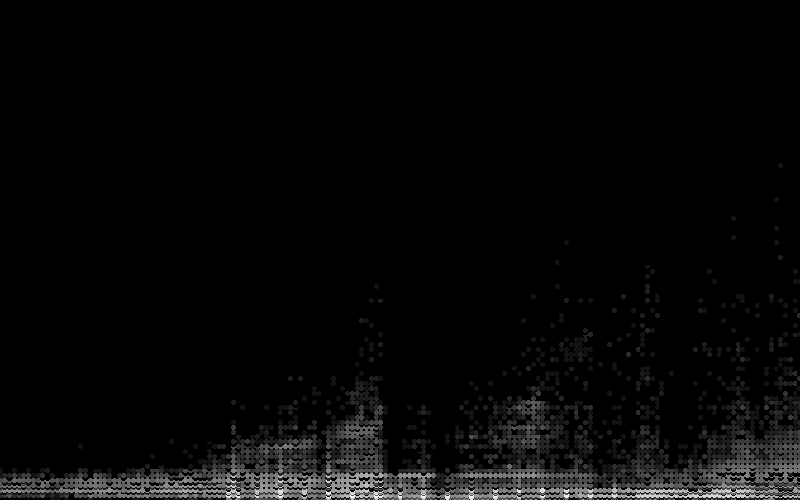

In [148]:
#Defining some helper functions for DataShader
background = "black"
export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

cvs = ds.Canvas(800, 500, x_range = (ny['yearbuilt'].min(), ny['yearbuilt'].max()), 
                                y_range = (ny['numfloors'].min(), ny['numfloors'].max()))
agg = cvs.points(ny, 'yearbuilt', 'numfloors')
view = tf.shade(agg, cmap = cm(Greys9), how='log')
export(tf.spread(view, px=2), 'yearvsnumfloors')

That's technically just a scatterplot, but the points are smartly placed and colored to mimic what one gets in a heatmap. Based on the pixel size, it will either display individual points, or will color the points of denser regions.

Datashader really shines when looking at geographic information. Here are the latitudes and longitudes of our dataset plotted out, giving us a map of the city colored by density of structures:

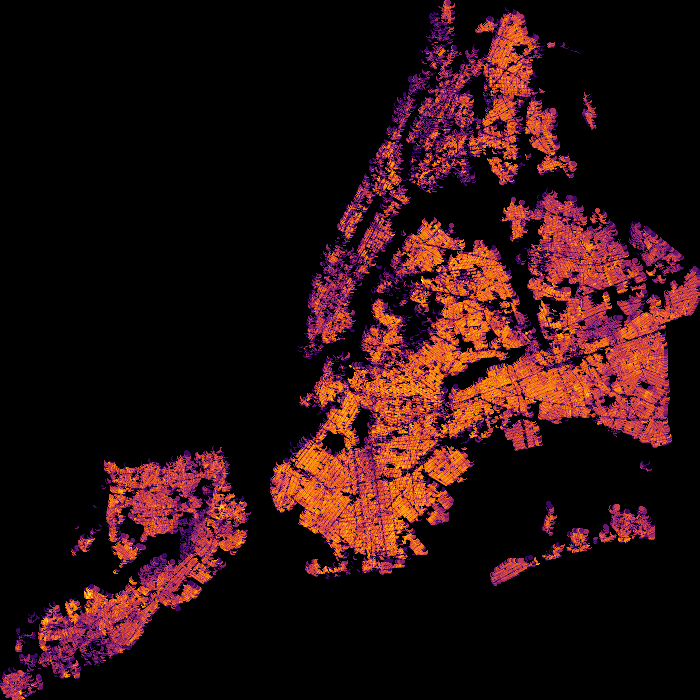

In [149]:
NewYorkCity   = (( 913164.0,  1067279.0), (120966.0, 272275.0))
cvs = ds.Canvas(700, 700, *NewYorkCity)
agg = cvs.points(ny_filtered, 'xcoord', 'ycoord')
view = tf.shade(agg, cmap = cm(inferno), how='log')
export(tf.spread(view, px=2), 'firery')


Interestingly, since we're looking at structures, the large buildings of Manhattan show up as less dense on the map. The densest areas measured by number of lots would be single or multi family townhomes.

Unfortunately, Datashader doesn't have the best documentation. Browse through the examples from their [github repo](https://github.com/bokeh/datashader/tree/master/examples). I would focus on the [visualization pipeline](https://anaconda.org/jbednar/pipeline/notebook) and the [US Census](https://anaconda.org/jbednar/census/notebook) Example for the question below. Feel free to use my samples as templates as well when you work on this problem.

### Question 2

<b>You work for a real estate developer and are researching underbuilt areas of the city. After looking in the [Pluto data dictionary](https://www1.nyc.gov/assets/planning/download/pdf/data-maps/open-data/pluto_datadictionary.pdf?v=17v1_1), you've discovered that all tax assessments consist of two parts: The assessment of the land and assessment of the structure. You reason that there should be a correlation between these two values: more valuable land will have more valuable structures on them (more valuable in this case refers not just to a mansion vs a bungalow, but an apartment tower vs a single family home). Deviations from the norm could represent underbuilt or overbuilt areas of the city. You also recently read a really cool blog post about [bivariate choropleth maps](http://www.joshuastevens.net/cartography/make-a-bivariate-choropleth-map/), and think the technique could be used for this problem.

Datashader is really cool, but it's not that great at labeling your visualization. Don't worry about providing a legend, but provide a quick explanation as to which areas of the city are overbuilt, which areas are underbuilt, and which areas are built in a way that's properly correlated with their land value.</b>

For this question we will focus on the following columns:

- `assessland` - assessed land value 
- `assesstot` - assessed lot value

We need to create a new column which is the difference between these two value's, which will be:

- `assessbldg` - assessed building value

#### Create bulding value column

In [150]:
# create assessbldg col
ny_filtered['assessbldg'] = ny_filtered['assesstot'] - ny_filtered['assessland']

#### Create colorkey


We also need to create a **colorkey**.<br>
Let's, create a color key based on one of Josha Stevens <a href="https://www.joshuastevens.net/cartography/make-a-bivariate-choropleth-map/">Bivariate Choropleth Maps: A How-to Guide</a> suggested color schemes:

<p align="center">
<img src="./img/color_pl.png", width='140',height='150'>
<img src="./img/color_scheme.png", width='150',height='150'>
</p>

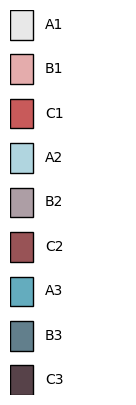

In [183]:
# create color key based on 
color_key = {'C3':'#574249', 
             'B3':'#627f8c',
             'A3':'#64acbe', 
             'C2':'#985356', 
             'B2':'#ad9ea5',
             'A2':'#b0d5df',
             'C1':'#c85a5a', 
             'B1':'#e4acac',
             'A1':'#e8e8e8'}

# lets view
# create figure to display the color key
fig, ax = plt.subplots(figsize=(1.5,5))

# iterate over the colors in the dictionary and create colored rectangles with labels
y_pos = 0
for color, hex in color_key.items():
    rect = mpatches.Rectangle((0, y_pos), 0.2, 0.2, ec='black', fc=hex)
    ax.add_patch(rect)
    ax.text(0.3, y_pos+0.1, color, fontsize=10, ha='left', va='center')
    y_pos += 0.3

# set the axis limits and hide the axis
ax.set_xlim(0, 1)
ax.set_ylim(0, y_pos-0.1)
ax.axis('off')

# save plot
plt.savefig("./img/color_key.png")

# show plot
plt.show()



#### Create label columns
Ok, now we need to create the labels for each color where `C1` (red tone) is more valuable land (variable two) not valuable buildings (variable one), and `A3` (aquamarine tone) is more valuable builing, not valuable land.

In [152]:
# create labels for land and buildings
land_lab = ['A','B','C'] 
build_lab = ['1','2','3']

# we will break it into 3 groups
grp = 100/3

# create breakpoints for for land and building cols
brk_land = np.percentile(ny_filtered['assessland'],[grp, 100 - grp], axis=0)
brk_build = np.percentile(ny_filtered['assessbldg'], [grp, 100 - grp], axis=0)

# create land and building bin
ny_filtered['land_bin'] = pd.cut(x=ny_filtered['assessland'],
                        bins=[0, brk_land[0], brk_land[1], float('inf')],
                        right=False,
                        labels=land_lab)
ny_filtered['build_bin'] = pd.cut(x=ny_filtered['assessbldg'],
                         bins=[0, brk_build[0], brk_build[1], float('inf')],
                         right=False,
                         labels=build_lab)

# meld land and building columns together to create color label to match with key
ny_filtered['color_key'] = ny_filtered['land_bin'].astype(str) + ny_filtered['build_bin'].astype(str)
ny_filtered['color_key'] = pd.Categorical(ny_filtered['color_key'])
ny_filtered.head()

,borough,zipcode,bldgclass,numbldgs,numfloors,yearbuilt,bbl,assessland,assesstot,xcoord,ycoord,numfloors_bin,assessbldg,land_bin,build_bin,color_key
0,BK,11216.0,A4,1.0,2.0,1899.0,3.018090e+09,14700.0,58800.0,999060.0,189645.0,0-9,44100.0,B,2,B2
1,BK,11204.0,B1,1.0,2.0,1930.0,3.061830e+09,15960.0,58740.0,986388.0,163190.0,0-9,42780.0,B,2,B2
2,BK,11204.0,B1,2.0,2.0,1930.0,3.062060e+09,12720.0,87060.0,986515.0,162427.0,0-9,74340.0,B,3,B3
3,BK,11216.0,C0,1.0,3.0,1899.0,3.018520e+09,11220.0,83400.0,1000530.0,187690.0,0-9,72180.0,A,3,A3
4,BK,11209.0,S2,1.0,3.0,1907.0,3.058930e+09,20760.0,78540.0,978343.0,169549.0,0-9,57780.0,C,2,C2


Now let's create a map of NYC uysing similar code from example. Here is the color key for comparision
<br><br>
<img src="./img/color_key.png">

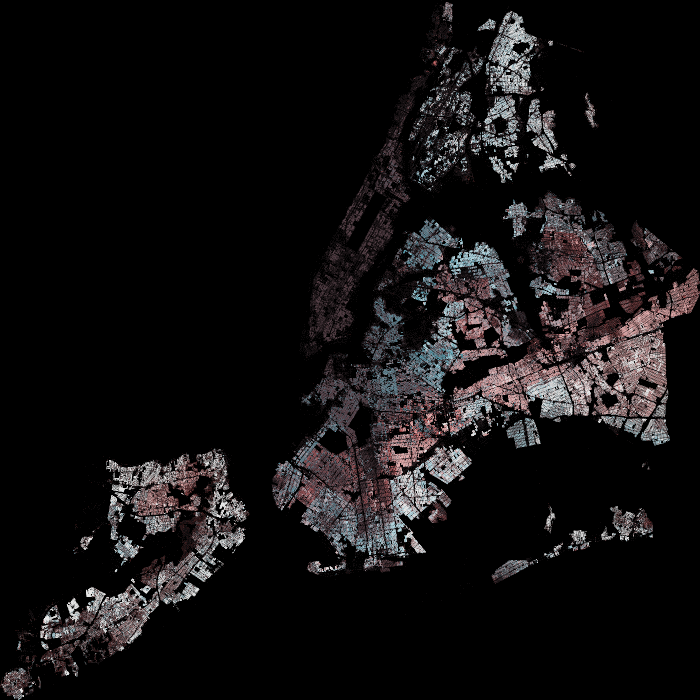

In [156]:
# plot
NewYorkCity   = (( 913164.0,  1067279.0), (120966.0, 272275.0))
cvs = ds.Canvas(700, 700, *NewYorkCity)
agg = cvs.points(ny_filtered, 'xcoord', 'ycoord', ds.count_cat('color_key'))
view = tf.shade(agg, color_key=color_key)
export(view, 'Final Image')

In conclusion, we can see that Manahattan, Central Brooklyn and Central Queens seem to have more valuable land, yet less valuable buildings (A3 or darker red tone). Whereas, the darker aquamarine tone (C1) which encompasses parts of North Eastern Brooklyn, and Western Queens are currently underdeveloped (more valuable land, less valuable buildings). 